In [1]:
import os
import numpy as np
import pandas as pd

In [54]:
plt.rcParams['figure.dpi'] = 300
sns.set_context('talk', font_scale= 1.5)

# Figure 1B

In [3]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20200508_maternal500_fetal_wo_outliers.csv')
adata_df = pd.read_csv(umap_path)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
clean_df = adata_df[(adata_df['test_status'] == 'test') & 
                    adata_df['organ'].isin(['PB', 'PL_F', 'PL_M'])]

In [5]:
bl_df = clean_df[(clean_df['challenge'] == 'sal') & (clean_df['timePI'] == '2hr') & (clean_df['origin'] == 'maternal')]

In [55]:
leiden_color_dictv2 = {'B cells': '#FFFF00',
 'CD4+ T cells': '#FF34FF',
 'CD8+ T cells': '#FF4A46',
 'Eosinophils': '#A30059',
 'Basophils': '#b98cdb',
 'Monocytes': '#552de3',
 'NK cells': '#8FB0FF',
 'Neutrophils': '#8393a3',                   
 'DCs': '#1CE6FF'}

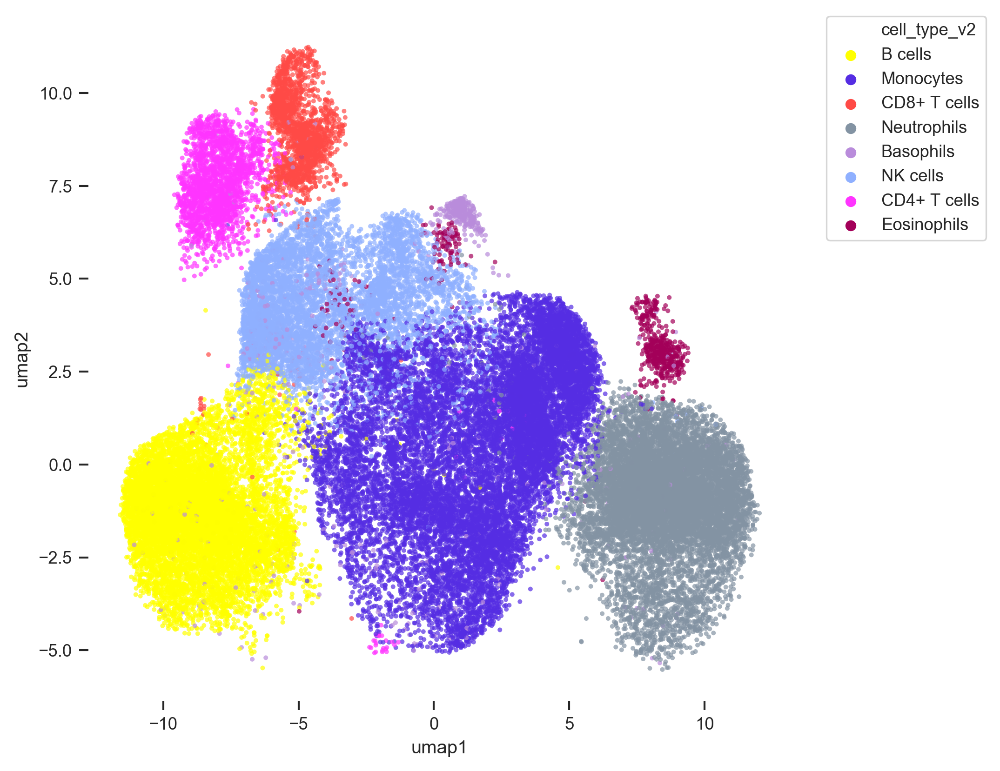

In [56]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.scatterplot(x='umap1', y='umap2', 
                data = bl_df, #size = 0.1, 
                hue = 'cell_type_v2', palette = leiden_color_dictv2, 
                marker='.', linewidth = 0, alpha = 0.7)
sns.set_style("whitegrid", {'axes.grid' : False})
sns.despine(f, left=True, bottom=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Figure 1C

In [8]:
clustering = ['Ly-6G', 'CD11c', 'CD3',  
              'IgD', 'CD11b','FcERI', 
              'Siglec-F','CD68','CD49b']

In [9]:
bl_df.columns

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6', 'day', 'organ', 'id', 'cage', 'timePI', 'challenge', 'origin',
       'location', 'leiden1', 'PD-L1_status', 'PD-1_status', 'CTLA-4_status',
       'CD64_status', 'CD62L_status', 'CD25_status', 'CD194_status',
       'CD69_status', 'CD80_status', 'CD86_status', 'B220_status',
       'CD40_status', 'CD44_status', 'IdU_status', 'cell_descript',
       'test_status', 'sample', 'cell_type', 'compartment', 'umap1', 'umap2',
       'cell_type_v2', 'compartment2'],
      dtype='object')

In [10]:
bl_df[clustering] = bl_df[clustering].apply(lambda x:(x-x.min()) / (x.max()-x.min()))
adata_melt= bl_df.melt(id_vars=['compartment2','cell_type_v2', 'cage','id', 'day', 'umap1', 'umap2'], value_vars = clustering)
adata_melt.rename(columns = {'variable': 'marker', 'value': 'median'}, inplace = True)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:3391: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[k1] = value[k2]


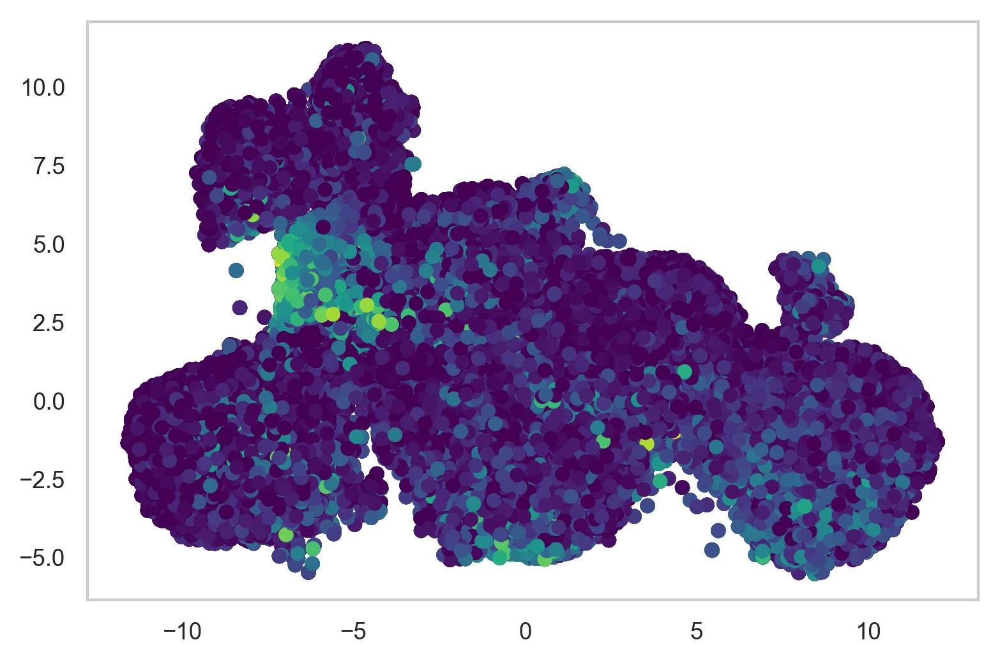

In [11]:
points = plt.scatter(adata_melt['umap1'], adata_melt['umap2'], c = adata_melt['median'], cmap='viridis')

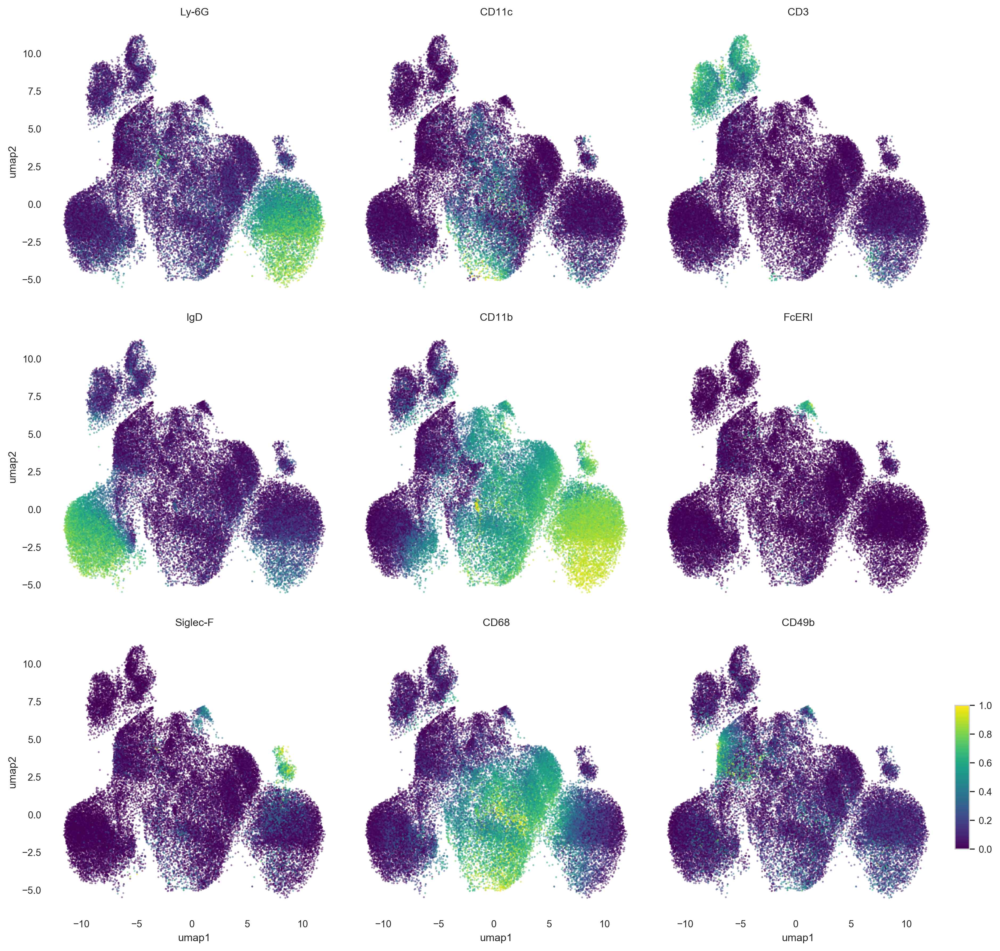

In [12]:
sns.set_context('paper', font_scale= 1)
g = sns.relplot(x='umap1', y= 'umap2', hue = 'median', col= 'marker', data= adata_melt,
                height=4, aspect=1, kind="scatter", palette = 'viridis', col_wrap=3,
                marker='.', size = 0.1, linewidth = 0, alpha = 0.5, legend = False).set_titles('{col_name}')
cax = g.fig.add_axes([1, 0.11, 0.015, 0.15])
plt.colorbar(points, cax=cax)
sns.despine(g, left=True, bottom=True)

# Figure 1D

In [13]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
medians_csv = '20200630_maternal500wo_outliers_bl_medians_per_sample.csv'
medians_filepath = os.path.join(subsample_path, medians_csv)
medians = pd.read_csv(medians_filepath)

In [14]:
medians.head(5)

,marker,cell_type_v2,compartment2,day,cage,id,median,sample,float_day
0,CD45-retroorbital,B cells,PB-EV,E10.5,6942,8,4.773626,6942_8_E10.5_PB-EV,10.5
1,CD45-retroorbital,B cells,PB-EV,E10.5,6943,15,4.397351,6943_15_E10.5_PB-EV,10.5
2,CD45-retroorbital,B cells,PB-EV,E10.5,6944,16,4.785401,6944_16_E10.5_PB-EV,10.5
3,CD45-retroorbital,B cells,PB-EV,E10.5,6944,17,2.063178,6944_17_E10.5_PB-EV,10.5
4,CD45-retroorbital,B cells,PB-EV,E10.5,9582,15,4.476063,9582_15_E10.5_PB-EV,10.5


In [15]:
medians['compartment2'].unique()

array(['PB-EV', 'PL-EV', 'PL-T'], dtype=object)

In [16]:
mean_medians = medians.groupby(['marker','cell_type_v2']).mean()

In [17]:
mean_medians.reset_index(inplace = True)

In [18]:
heatmap_df = mean_medians.pivot_table(index = 'cell_type_v2', columns = 'marker', values = 'median')

In [19]:
heatmap_df

marker,B220,CD115,CD11b,CD11c,CD19,CD194,CD25,CD3,CD4,CD40,...,NKp46,PD-1,PD-L1,Siglec-F,TCRb,TCRgd,c-Kit,prpS6,umap1,umap2
cell_type_v2,,,,,,,,,,,,,,,,,,,,,
B cells,1.977557,0.295517,0.483680,0.111149,1.276878,0.472095,0.330283,0.068502,0.357839,1.614311,...,0.014559,0.510373,1.153590,0.006473,0.141377,0.002823,0.015107,0.117416,-8.801850,-1.422523
Basophils,1.222602,0.346514,3.096487,0.287457,0.378505,0.854429,0.374407,0.222617,1.173004,1.839882,...,0.081619,0.601998,2.029647,0.765705,0.266708,0.034930,0.081394,0.198319,-1.965122,2.271917
CD4+ T cells,1.030218,0.331449,0.711812,0.077556,0.121137,0.653295,0.136201,3.202506,3.153818,1.513313,...,0.020777,0.687890,0.911142,0.012961,1.856900,0.063796,0.040544,0.165665,-7.921396,7.555000
CD8+ T cells,1.072037,0.317091,0.681355,0.117755,0.127240,0.954285,0.161131,3.027811,0.280035,1.702933,...,0.018272,0.285936,0.995039,0.025605,1.688420,0.055134,0.017496,0.219223,-4.983765,8.926908
Eosinophils,1.264147,0.286834,5.317944,0.229212,0.221241,0.691271,0.371122,0.206800,1.689257,1.719590,...,0.162368,0.471983,0.478296,3.120269,0.152170,0.024993,0.055515,0.201842,7.094424,3.504384
Monocytes,1.132323,0.440949,4.460857,0.365744,0.072148,1.740159,0.205044,0.075326,1.327866,1.732505,...,0.017083,0.469463,0.843361,0.034162,0.144273,0.011616,0.013867,0.156696,1.929057,0.679601
NK cells,0.934431,0.149294,2.378226,0.324479,0.050273,0.462748,0.127196,0.054812,0.463689,1.505614,...,0.088499,0.240356,0.952252,0.014035,0.091177,0.002908,0.035475,0.143105,-2.920263,4.374572
Neutrophils,1.172956,0.408821,6.209172,0.196821,0.367329,0.830818,0.718115,0.303326,1.744380,1.147776,...,0.014771,0.490420,0.316571,0.230168,0.219914,0.040252,0.088722,0.100806,8.464890,-1.040285


In [20]:
clustering_full = ['Ly-6G', 'CD11c', 'TCRb', 'F480', 'CD3', 
              'IgD', 'IgM','CD19', 'CD8', 'CD11b',
              'Ly-6C','FcERI', 'Siglec-F','CD68', 
              'CD49b', 'CD4', 'MHCII']

In [21]:
row_colors = heatmap_df.index.map(leiden_color_dictv2)

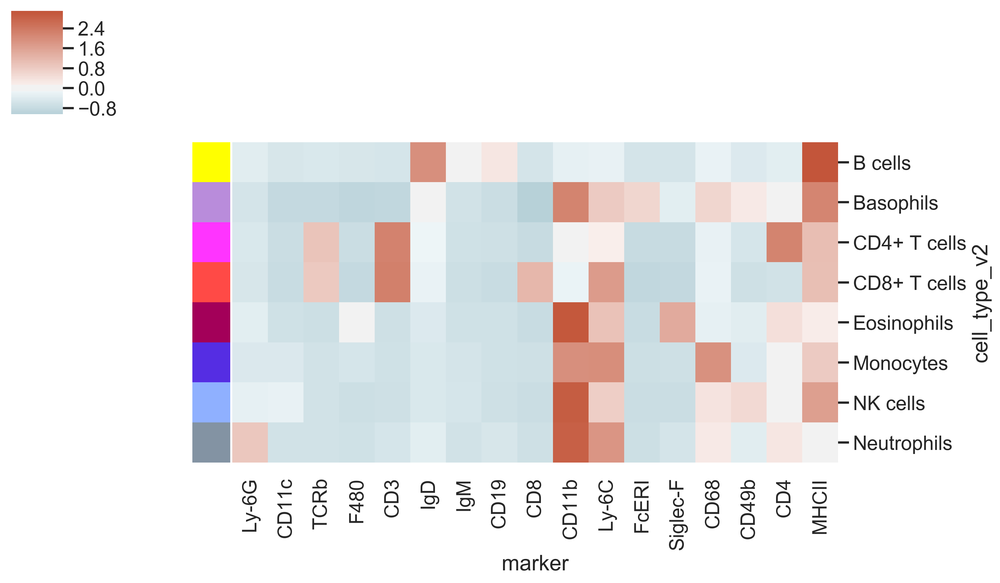

In [28]:
sns.set_context('talk', font_scale= 1)
cg = sns.clustermap(heatmap_df.loc[:, clustering_full], figsize=(12, 6),
               cmap = sns.diverging_palette(220, 20, n=200), row_colors = row_colors, 
               row_cluster = False, col_cluster = False,
                   z_score = 0, center = 0)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((.1,0.8,.05,.2))

In [24]:
heatmap_df_norm = heatmap_df.apply(lambda x:(x-x.min()) / (x.max()-x.min()), axis = 0)

In [25]:
row_colors2 = heatmap_df_norm.index.map(leiden_color_dictv2)

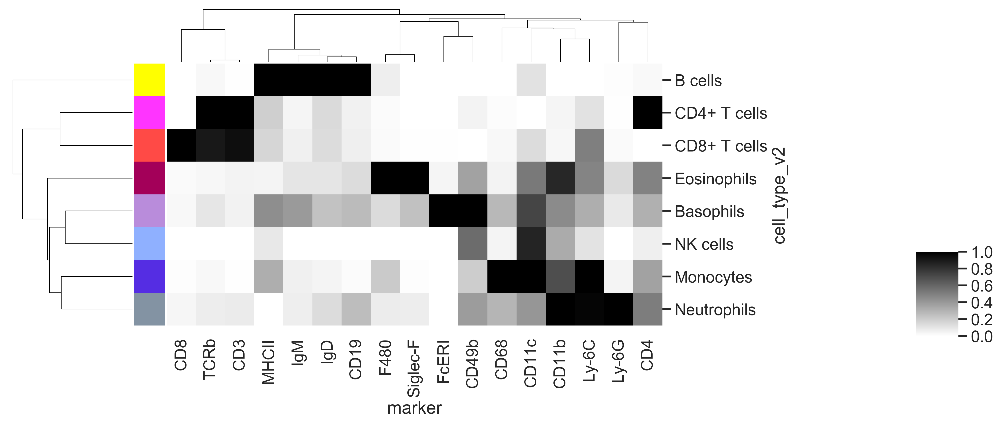

In [29]:
sns.set_context('talk', font_scale= 1)
cg = sns.clustermap(heatmap_df_norm.loc[:, clustering_full], figsize=(12, 6),
               cmap = 'binary', row_colors = row_colors2, 
               row_cluster = True, col_cluster = True)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((1.2,0.1,.05,.2))

In [48]:
bl_df.columns

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6', 'day', 'organ', 'id', 'cage', 'timePI', 'challenge', 'origin',
       'location', 'leiden1', 'PD-L1_status', 'PD-1_status', 'CTLA-4_status',
       'CD64_status', 'CD62L_status', 'CD25_status', 'CD194_status',
       'CD69_status', 'CD80_status', 'CD86_status', 'B220_status',
       'CD40_status', 'CD44_status', 'IdU_status', 'cell_descript',
       'test_status', 'sample', 'cell_type', 'compartment', 'umap1', 'umap2',
       'cell_type_v2', 'compartment2'],
      dtype='object')

# Figure 1E

In [49]:
comp_dict = {'PB-EV':'firebrick','PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'}

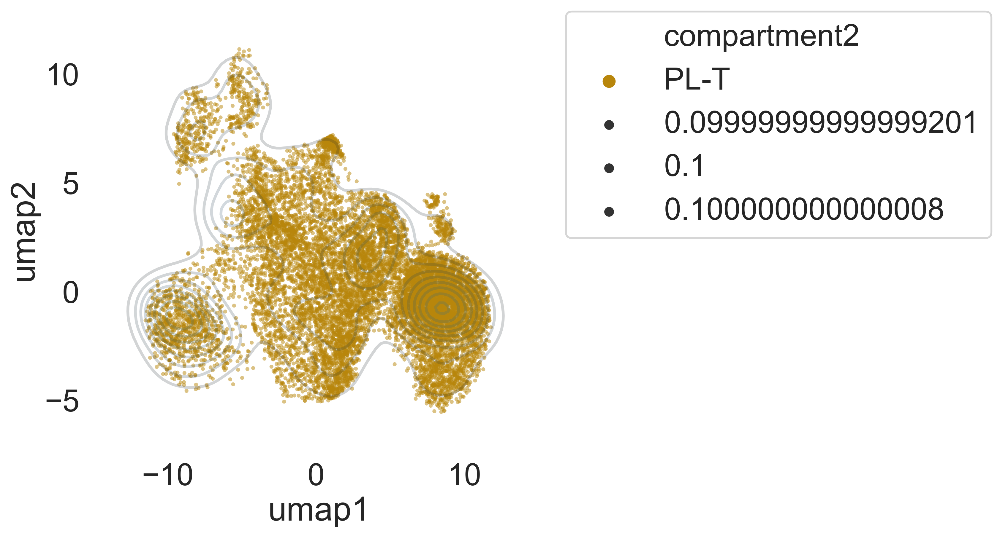

In [50]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = bl_df['umap1'], data2=bl_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)

sns.scatterplot(data = bl_df[bl_df['compartment2'] == 'PL-T'], 
                hue = 'compartment2', palette = comp_dict, x='umap1', y='umap2', marker='.', size = 0.1, 
                linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

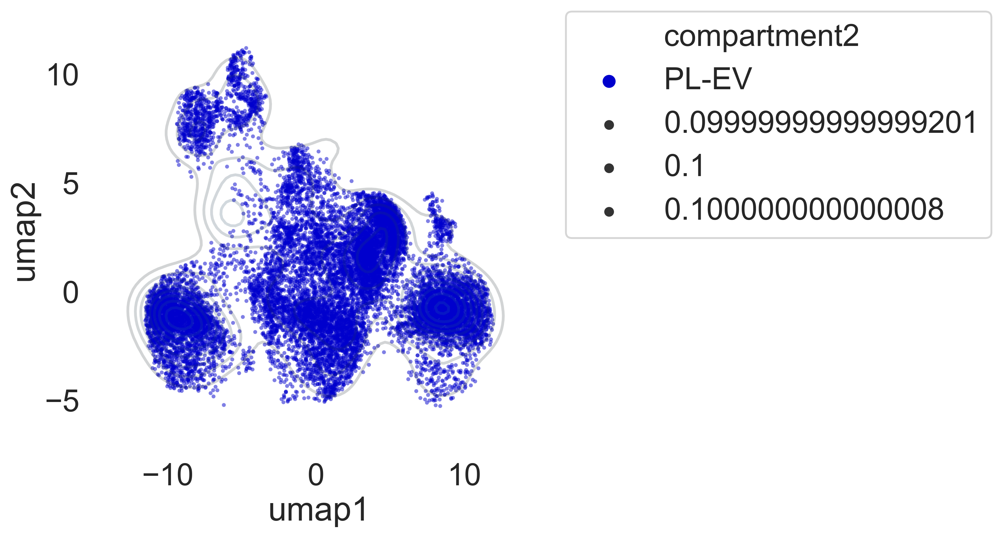

In [51]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = bl_df['umap1'], data2=bl_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)

sns.scatterplot(data = bl_df[bl_df['compartment2'] == 'PL-EV'], 
                hue = 'compartment2', palette = comp_dict, x='umap1', y='umap2', marker='.', size = 0.1, 
                linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

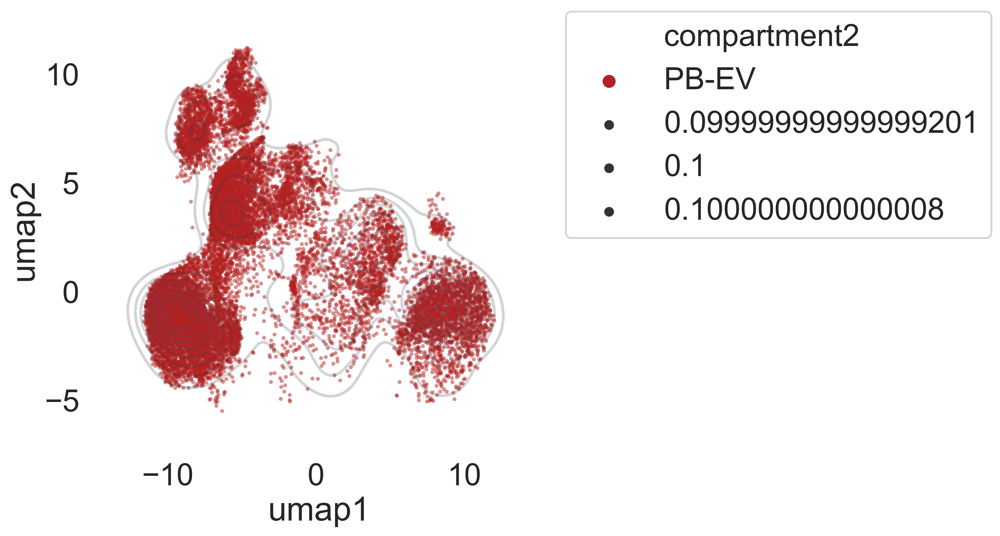

In [52]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = bl_df['umap1'], data2=bl_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)

sns.scatterplot(data = bl_df[bl_df['compartment2'] == 'PB-EV'], 
                hue = 'compartment2', palette = comp_dict, x='umap1', y='umap2', marker='.', size = 0.1, 
                linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Figure 1F

In [6]:
bl_df.columns

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6', 'day', 'organ', 'id', 'cage', 'timePI', 'challenge', 'origin',
       'location', 'leiden1', 'PD-L1_status', 'PD-1_status', 'CTLA-4_status',
       'CD64_status', 'CD62L_status', 'CD25_status', 'CD194_status',
       'CD69_status', 'CD80_status', 'CD86_status', 'B220_status',
       'CD40_status', 'CD44_status', 'IdU_status', 'cell_descript',
       'test_status', 'sample', 'cell_type', 'compartment', 'umap1', 'umap2',
       'cell_type_v2', 'compartment2'],
      dtype='object')

In [7]:
bl_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,IdU_status,cell_descript,test_status,sample,cell_type,compartment,umap1,umap2,cell_type_v2,compartment2
1526,4.887950,3.094432,0.000000,0.346289,2.287175,1.281783,0.282454,0.009124,0.986773,0.009731,...,IdU-,B cells CD11b-_E15.5_sal_2hr_9582_14_PL_F_EV,test,E15.5_9582_14,B cells IgMneg,PL_F-EV,-10.497479,-2.063933,B cells,PL-EV
1527,4.440127,3.113236,0.000000,0.917495,1.681932,1.248900,0.003837,0.565267,0.216015,0.009731,...,IdU-,Monocytes Ly6C+MHCII+_E15.5_sal_2hr_9582_14_PL...,test,E15.5_9582_14,Monocytes Ly6Cmid,PL_F-EV,1.797786,-1.826254,Monocytes,PL-EV
1528,3.592813,2.023786,0.102777,0.323869,1.415480,0.299612,0.084553,0.009124,0.017124,0.009731,...,IdU-,Monocytes Ly6CrangeCD11b-_E15.5_sal_2hr_9582_1...,test,E15.5_9582_14,Monocytes Ly6Cmid,PL_F-EV,-2.867521,0.332538,Monocytes,PL-EV
1529,4.770346,2.718503,0.685315,0.001446,2.603251,0.134587,0.378699,0.009124,0.017124,0.009731,...,IdU-,B cells CD11b-_E15.5_sal_2hr_9582_14_PL_F_EV,test,E15.5_9582_14,B cells IgMneg,PL_F-EV,-10.175566,-1.451660,B cells,PL-EV
1530,1.471493,3.678320,0.000000,5.177753,1.015315,0.350451,2.000770,0.386624,0.791681,0.429151,...,IdU+,Monocytes Ly6C-MHCII+_E15.5_sal_2hr_9582_14_PL...,test,E15.5_9582_14,Monocytes Ly6Clo/neg,PL_F-T,-0.955799,-1.288894,Monocytes,PL-T


In [35]:
bl_df['id'] = bl_df['id'].astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [36]:
bl_df['cage'].unique()

array([9582, 9580, 1136, 8241, 8238, 8240, 2849, 6943, 6942, 6944, 6941,
       9581, 9583,  429,  428])

In [37]:
cell_counts = pd.DataFrame(data = bl_df.groupby(['cell_type_v2', 'compartment2', 'day', 'challenge','timePI','cage', 'id']).apply(len))
cell_counts.reset_index(inplace = True)
cell_counts.rename(columns = {0: 'counts'}, inplace = True)
cell_counts['sample'] = cell_counts['cage'].astype(str).str.cat(cell_counts['id'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['day'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['challenge'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['timePI'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['compartment2'], sep= '_')

In [38]:
cell_counts[cell_counts['sample'] == '429_19_E11.5_sal_2hr_PL-T']

,cell_type_v2,compartment2,day,challenge,timePI,cage,id,counts,sample
72,B cells,PL-T,E11.5,sal,2hr,429,19,70,429_19_E11.5_sal_2hr_PL-T
162,Basophils,PL-T,E11.5,sal,2hr,429,19,29,429_19_E11.5_sal_2hr_PL-T
265,CD4+ T cells,PL-T,E11.5,sal,2hr,429,19,28,429_19_E11.5_sal_2hr_PL-T
368,CD8+ T cells,PL-T,E11.5,sal,2hr,429,19,20,429_19_E11.5_sal_2hr_PL-T
467,Eosinophils,PL-T,E11.5,sal,2hr,429,19,28,429_19_E11.5_sal_2hr_PL-T
570,Monocytes,PL-T,E11.5,sal,2hr,429,19,252,429_19_E11.5_sal_2hr_PL-T
673,NK cells,PL-T,E11.5,sal,2hr,429,19,64,429_19_E11.5_sal_2hr_PL-T
776,Neutrophils,PL-T,E11.5,sal,2hr,429,19,162,429_19_E11.5_sal_2hr_PL-T


In [39]:
sample_total = pd.DataFrame(data = cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
cell_counts.loc[:,'sample_total'] = cell_counts['sample'].map(sample_dict['counts'])
cell_counts['frac_of_comp_sample'] = cell_counts['counts']/cell_counts['sample_total']
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20201014_maleandfemcombmaternal500wo_outliers_counts_per_sample_meta_clust.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
cell_counts.to_csv(counts_filepath, index = False)       

In [42]:
cell_list = cell_counts['cell_type_v2'].unique().tolist()

In [43]:
bl_counts_piv = cell_counts.pivot_table(index = ['compartment2',  
                                                     'day', 'challenge', 
                                                     'timePI', 'cage', 'id'], columns = 'cell_type_v2', values = 'frac_of_comp_sample')
bl_counts_piv.reset_index(inplace = True)

In [44]:
bl_counts_piv.loc[:,cell_list] = bl_counts_piv.loc[:,cell_list].fillna(0)

In [45]:
bl_counts_piv.loc[:, 'cage'] = bl_counts_piv.loc[:, 'cage'].astype('category')
composite = bl_counts_piv.groupby(['compartment2']).agg(['mean', 'sem'])
mean_sem_comp = composite.reorder_levels([1, 0], axis = 1) 
mean_sem_comp.sort_index(axis = 0, ascending = False, inplace = True)
composite_T = mean_sem_comp['mean'].transpose()
composite_T.reset_index(inplace = True)
int_to_cell = composite_T[['index']].to_dict()
bars_dict = {}
for leiden in composite_T.index:
    bars_dict[leiden] = composite_T.iloc[leiden, 1:]
height_dict = {}
for leiden in composite_T.index:
    height_dict[leiden] = composite_T.iloc[leiden+1:,1:].sum().tolist()

In [53]:
composite_T.sum(axis = 0)

compartment2
index    B cellsBasophilsCD4+ T cellsCD8+ T cellsEosino...
PL-T                                                     1
PL-EV                                                    1
PB-EV                                                    1
dtype: object

In [11]:
height_dict

{0: [0.91166970636074, 0.7788531790241502, 0.6482694037005649],
 1: [0.8759273736465437, 0.7729195259752388, 0.6366908520181246],
 2: [0.8542422555628246, 0.7348585450736456, 0.5621573875105326],
 3: [0.8364959592847526, 0.7070185439449748, 0.49610408705727727],
 4: [0.814196381707216, 0.6946405664237116, 0.4883430467507037],
 5: [0.4403140534561255, 0.22054028069649778, 0.3889122018531484],
 6: [0.36192287947697943, 0.17071518997055107, 0.1366020744967099],
 7: [0.0, 0.0, 0.0]}

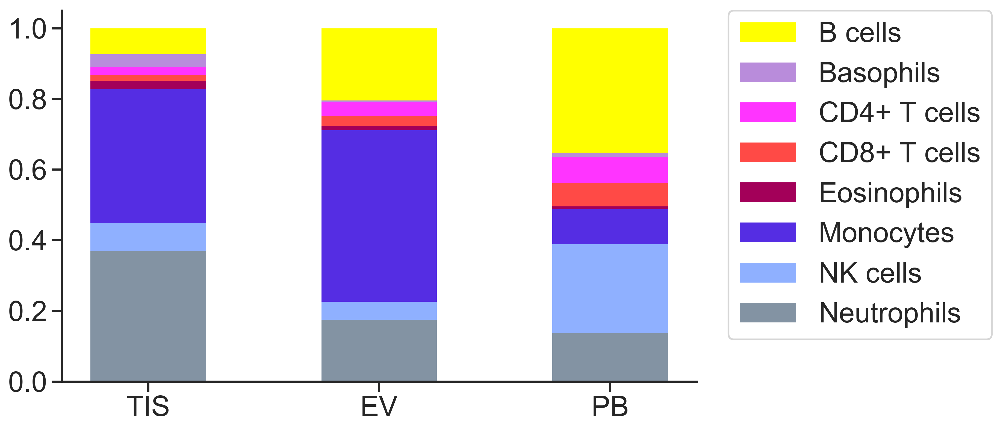

In [50]:
sns.set_style("ticks")
plt.figure(figsize=(10,6)) 
# The position of the bars on the x-axis
r = [0,0.2,0.4]
 
# Names of group and bar width
names = ['TIS','EV','PB']
barWidth = 0.10

for leiden in composite_T.index:
    plt.bar(r, bars_dict[leiden], color = leiden_color_dictv2[int_to_cell['index'][leiden]], bottom = height_dict[leiden], width=barWidth, linewidth = 0)
plt.xticks(r, names);
plt.legend(composite_T['index'], bbox_to_anchor=(1.05, 1), borderaxespad=0., ncol=1)
sns.despine(right = True, top = True)

# Figure 1G

In [57]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

In [58]:
features = cell_counts['cell_type_v2'].unique().tolist()
target = ['compartment2']
X = bl_counts_piv.loc[:, features].values
Y = bl_counts_piv.loc[:, target].values
model2 = LinearDiscriminantAnalysis()
lda2 = model2.fit_transform(X, Y)
LDA_df2 = pd.DataFrame(data = lda2, columns = ['LDA 1', 'LDA 2'])
LDA2 = pd.concat([bl_counts_piv, LDA_df2], axis = 1)
scalings_df2 = pd.DataFrame(index = features, data = abs(model2.scalings_), columns = ['scalings 1', 'scalings 2'])

/Users/bendalllab/Library/Python/3.7/lib/python/site-packages/sklearn/utils/validation.py:73: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


In [63]:
compartments = LDA2['compartment2'].unique().tolist()

In [64]:
comp_dict2 = {'PB-EV':'Reds','PL-EV': 'Blues', 'PL-T': 'Wistia'}

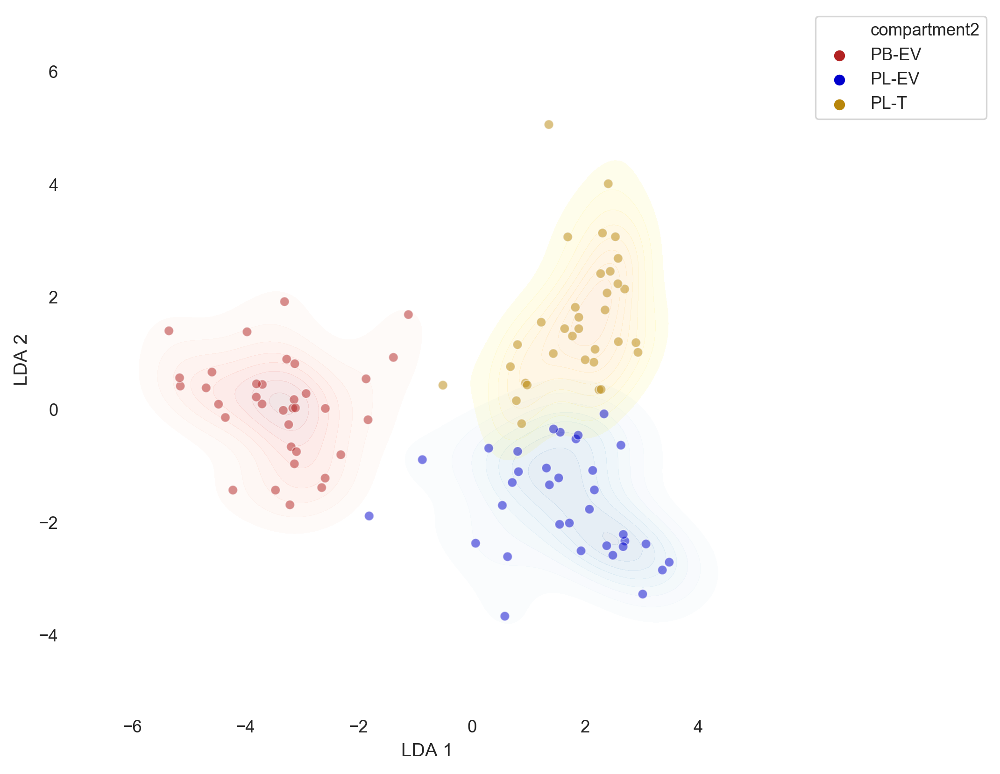

In [65]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
for comp in compartments:
    df = LDA2[LDA2['compartment2'] == comp]
    sns.kdeplot(df['LDA 1'], df['LDA 2'], shade = True, 
            shade_lowest=False, ax = ax, alpha = 0.1, cmap = comp_dict2[comp])
sns.scatterplot(data = LDA2, hue = 'compartment2', palette = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'},
                x= 'LDA 1', y='LDA 2', marker='o', linewidth = 0.5, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Get LDA components

In [66]:
model2.explained_variance_ratio_

array([0.76825928, 0.23174072])

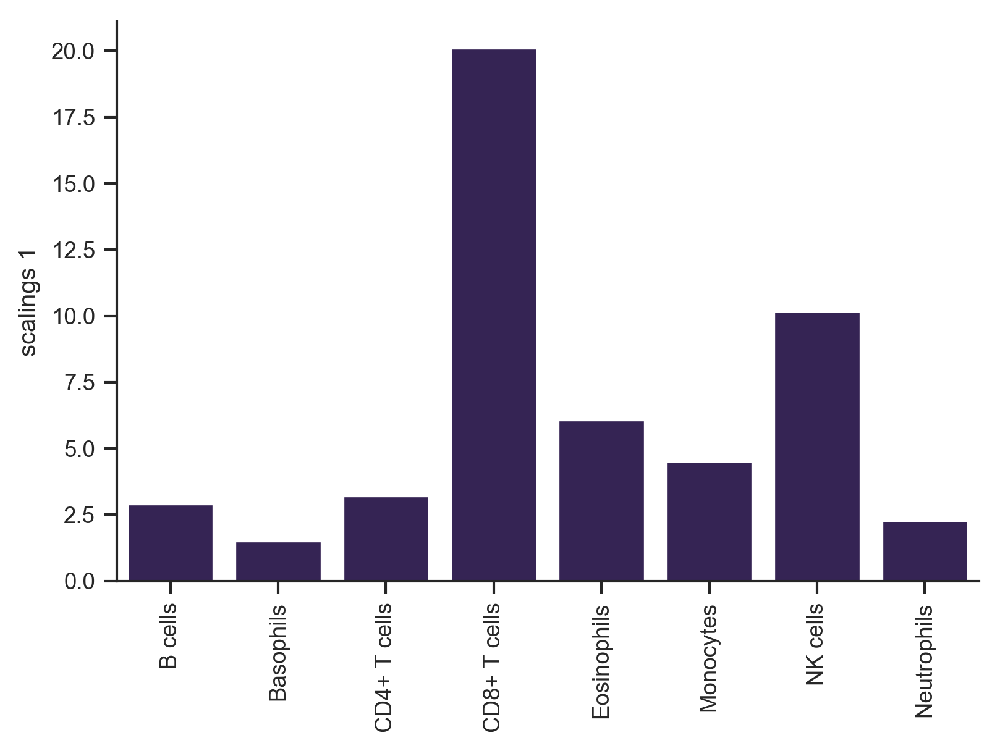

In [67]:
sns.set_style("ticks")
sns.barplot(x= scalings_df2.index, y = 'scalings 1', color = '#321c5c', data = scalings_df2 )
plt.xticks(rotation=90)
sns.despine(right = True, top = True)

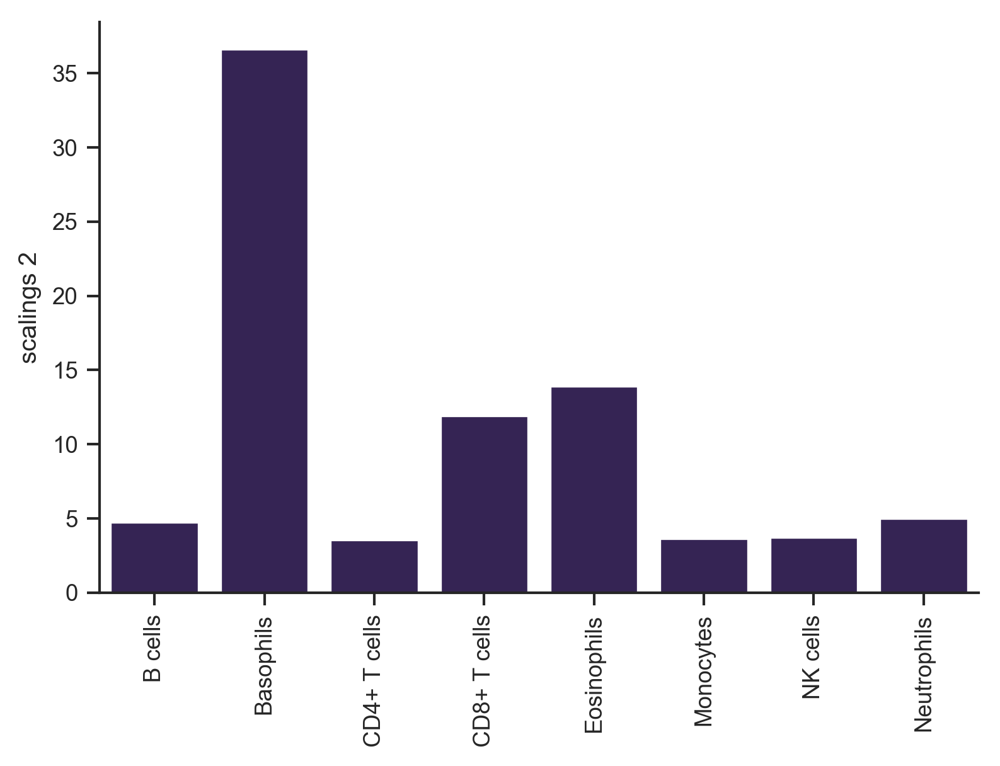

In [68]:
sns.set_style("ticks")
sns.barplot(x= scalings_df2.index, y = 'scalings 2', color = '#321c5c', data = scalings_df2 )
plt.xticks(rotation=90)
sns.despine(right = True, top = True)

In [74]:
LDA2.head(5)

,compartment2,day,challenge,timePI,cage,id,B cells,Basophils,CD4+ T cells,CD8+ T cells,Eosinophils,Monocytes,NK cells,Neutrophils,LDA 1,LDA 2
0,PB-EV,E10.5,sal,2hr,6942,8,0.392713,0.022267,0.046559,0.078947,0.012146,0.121457,0.176113,0.149798,-2.890201,0.296779
1,PB-EV,E10.5,sal,2hr,6943,15,0.518595,0.010331,0.051653,0.080579,0.004132,0.128099,0.101240,0.105372,-2.626865,-1.380014
2,PB-EV,E10.5,sal,2hr,6944,16,0.286290,0.054435,0.018145,0.030242,0.010081,0.135081,0.328629,0.137097,-3.280560,1.894124
3,PB-EV,E10.5,sal,2hr,6944,17,0.498969,0.000000,0.053608,0.047423,0.008247,0.065979,0.288660,0.037113,-4.248986,-1.456375
4,PB-EV,E10.5,sal,2hr,9582,15,0.294118,0.006536,0.156863,0.128540,0.006536,0.078431,0.193900,0.135076,-3.747140,0.491222


In [69]:
from skbio.diversity import beta_diversity

In [70]:
cell_counts_piv2 = cell_counts.pivot_table(index = 'compartment2', 
                                          columns = 'cell_type_v2', 
                                     values = 'frac_of_comp_sample', 
                                          aggfunc = np.mean, fill_value = 0)

In [71]:
baseline_comp = beta_diversity("braycurtis", cell_counts_piv2.values, cell_counts_piv2.index)

In [72]:
baseline_bc = pd.DataFrame(baseline_comp.data, index = cell_counts_piv2.index, columns = cell_counts_piv2.index)

In [73]:
mask = pd.DataFrame(data = {'PB-EV': [False, False, False], 'PL-EV': [True, False, False], 'PL-T': [True, True, False]}, index = ['PB-EV', 'PL-EV', 'PL-T'])

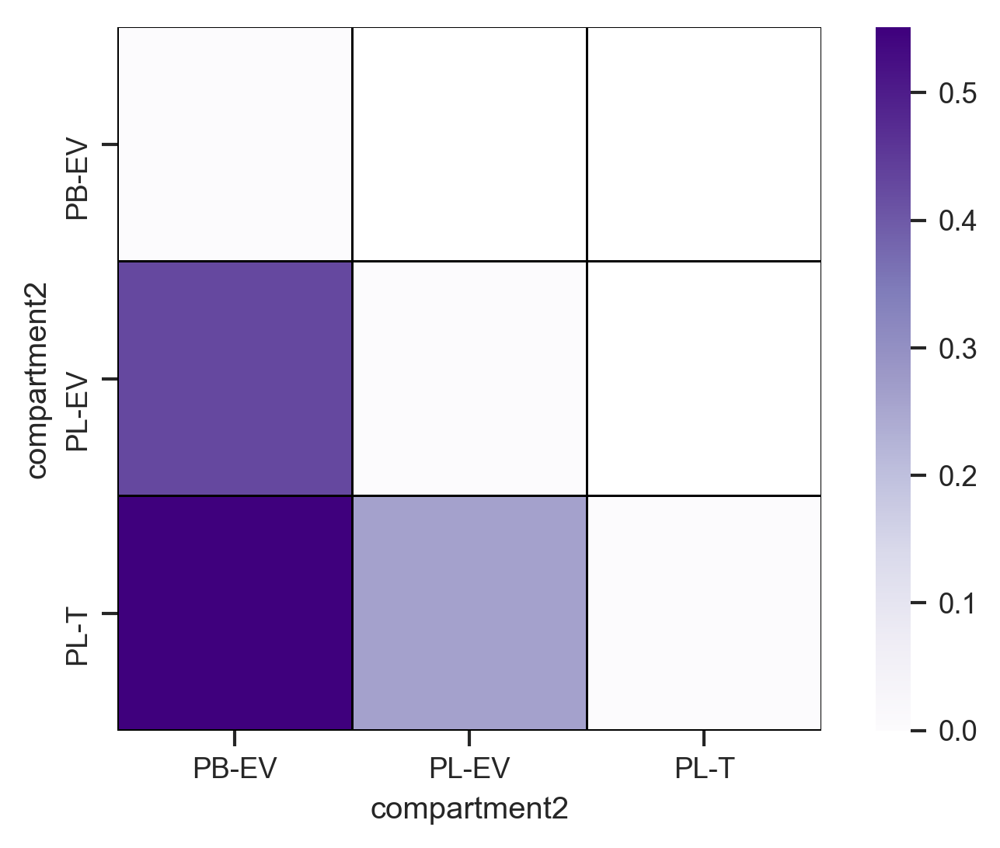

In [74]:
sns.heatmap(baseline_bc, mask = mask, square = True, cmap = 'Purples', linewidths=0.5, linecolor='black')